# Transformasi Linier Brightness

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import numpy as np
import matplotlib.pyplot as plt


Mengubah tingkat kecerahan Citra
--------------------------------
Masukan nilai kecerahan: 50


/tmp/ipython-input-2598027542.py:15: RuntimeWarning: overflow encountered in scalar add
  brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)


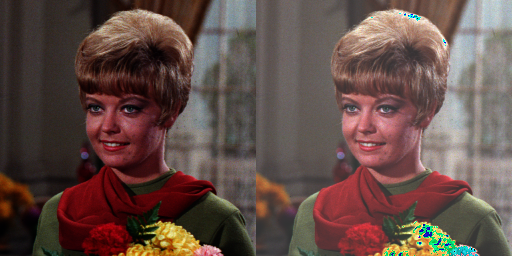

In [3]:
print('Mengubah tingkat kecerahan Citra')
print('--------------------------------')
try:
  brightness = int(input('Masukan nilai kecerahan: '))
except:
  print('Nilai harus berupa angka')

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

# TUGAS PRAKTIKUM D1

## 1. Implementasikan inverse citra pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori, sehingga menghasilkan keluaran seperti berikut:

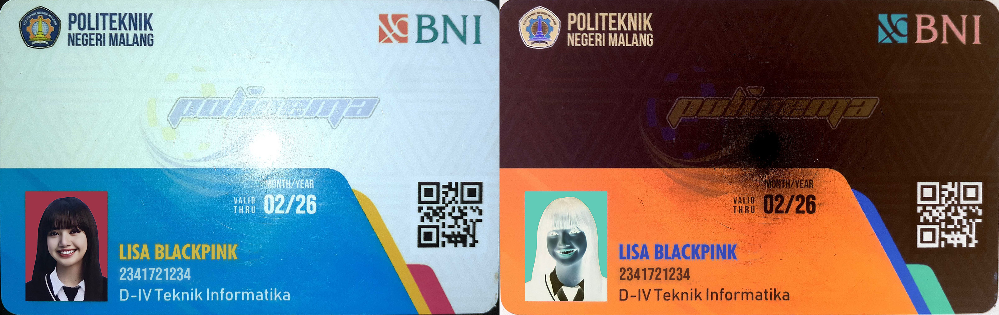

In [4]:
ktm = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Week2/images/lisa_ktm.jpg')
ktm_inverse = cv.bitwise_not(ktm)

final_ktm = cv.hconcat((ktm, ktm_inverse))
cv2_imshow(final_ktm)


## 2. Implementasikan transformasi contrast pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori untuk kontras,

Mengubah tingkat kecerahan & kontras Citra
--------------------------------
Masukan nilai kecerahan: 50
Masukan nilai kontras: 2


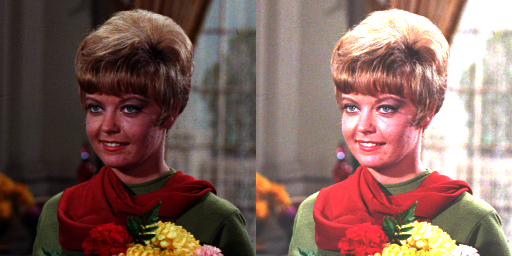

In [5]:
print('Mengubah tingkat kecerahan & kontras Citra')
print('--------------------------------')

try:
    brightness = int(input('Masukan nilai kecerahan: '))
except:
    print('Nilai harus berupa angka')
    brightness = 0

try:
    contrast = float(input('Masukan nilai kontras: '))
except:
    print('Nilai harus berupa angka')
    contrast = 1.0

# Baca citra
original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

adjusted_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      adjusted_image[y,x,c] = np.clip(original[y,x,c] * contrast + brightness, 0, 255)

final_frame = cv.hconcat((original, adjusted_image))
cv2_imshow(final_frame)

Cara lain:

## 3. Implementasikan transformasi logarithmic brightness pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori untuk transformasi log,

Mengubah tingkat kecerahan Citra
--------------------------------
Masukan nilai kecerahan: 50


/tmp/ipython-input-911828623.py:21: RuntimeWarning: overflow encountered in scalar add
  s = c * math.log(1 + r + brightness)


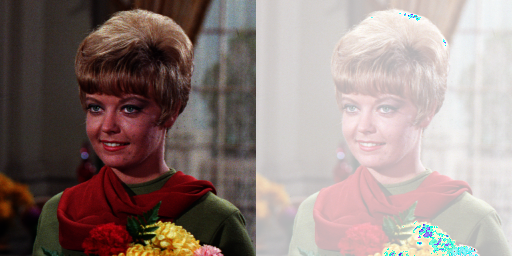

In [6]:
import math

print('Mengubah tingkat kecerahan Citra')
print('--------------------------------')
try:
  brightness = int(input('Masukan nilai kecerahan: '))
except:
  print('Nilai harus berupa angka')

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

brightness_image = np.zeros(original.shape, dtype=np.uint8)

# Konstanta c
c = 255 / np.log(1 + np.max(original))

for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        for c_channel in range(original.shape[2]):
            r = original[y, x, c_channel]
            s = c * math.log(1 + r + brightness)
            brightness_image[y, x, c_channel] = np.clip(s, 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

## 4. Implementasikan transformasi grayscale menggunakan metode averaging, lightness, dan luminance pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori

In [7]:
ktm_lisa = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Week2/images/lisa_ktm.jpg')


### a. Averaging

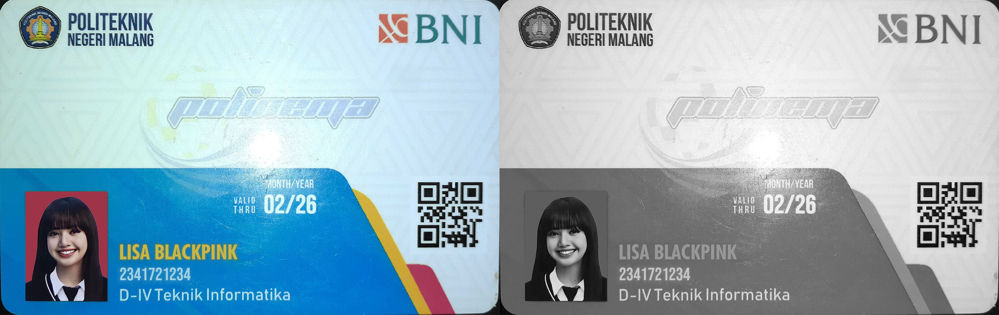

In [14]:
ktm_lisa_gray_avg = np.zeros((ktm_lisa.shape[0], ktm_lisa.shape[1]), dtype=np.uint8)

for y in range(ktm_lisa.shape[0]):
    for x in range(ktm_lisa.shape[1]):
        ktm_lisa_gray_avg[y, x] = np.mean(ktm_lisa[y, x])

# Ubah grayscale ke 3 channel biar bisa concat
final_ktm_gray_avg = cv.hconcat((ktm_lisa, cv.cvtColor(ktm_lisa_gray_avg, cv.COLOR_GRAY2BGR)))
cv2_imshow(final_ktm_gray_avg)

### b.lightness

/tmp/ipython-input-4098114192.py:9: RuntimeWarning: overflow encountered in scalar add
  gray_val = (max(R, G, B) + min(R, G, B)) // 2


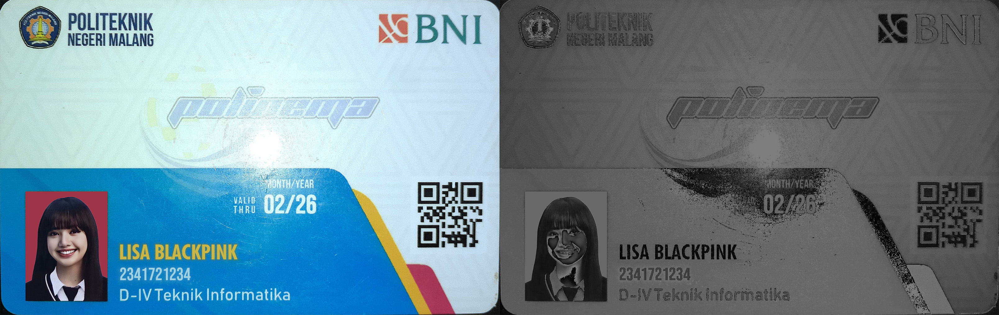

In [13]:
ktm_lisa_gray_lightness = np.zeros((ktm_lisa.shape[0], ktm_lisa.shape[1]), dtype=np.uint8)

# Loop pixel per pixel
for y in range(ktm_lisa.shape[0]):
    for x in range(ktm_lisa.shape[1]):
        B = ktm_lisa[y, x, 0]
        G = ktm_lisa[y, x, 1]
        R = ktm_lisa[y, x, 2]
        gray_val = (max(R, G, B) + min(R, G, B)) // 2
        ktm_lisa_gray_lightness[y, x] = gray_val

final_ktm_gray_lightness = cv.hconcat((ktm_lisa, cv.cvtColor(ktm_lisa_gray_lightness, cv.COLOR_GRAY2BGR)))
cv2_imshow(final_ktm_gray_lightness)

### c. Luminance

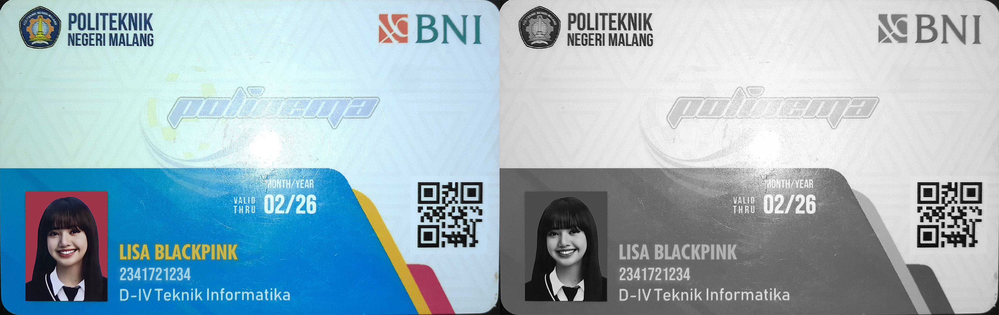

In [11]:
ktm_lisa_gray_luminance = np.zeros((ktm_lisa.shape[0], ktm_lisa.shape[1]), dtype=np.uint8)

# Loop pixel per pixel
for y in range(ktm_lisa.shape[0]):
    for x in range(ktm_lisa.shape[1]):
        B = ktm_lisa[y, x, 0]
        G = ktm_lisa[y, x, 1]
        R = ktm_lisa[y, x, 2]
        gray_val = (0.21 * R) + (0.72 * G) + (0.07 * B)
        ktm_lisa_gray_luminance[y, x] = gray_val

final_ktm_gray_avg = cv.hconcat((ktm_lisa, cv.cvtColor(ktm_lisa_gray_luminance, cv.COLOR_GRAY2BGR)))
cv2_imshow(final_ktm_gray_avg)

## 5. Tampilkanlah warna tertentu pada citra, dan ubah warna lain menjadi grayscale. Misal, tampilkan warna biru pada citra masukan dan ubah bagian lain yang tidak berwarna biru menjadi grayscale seperti pada contoh berikut:

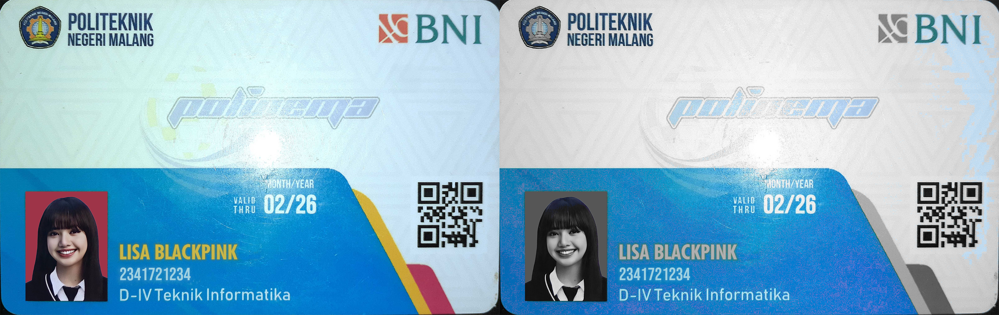

In [16]:
# Konversi ke HSV
hsv = cv.cvtColor(ktm_lisa, cv.COLOR_BGR2HSV)

# Rentang warna biru dalam HSV
lower_blue = np.array([50, 50, 50])
upper_blue = np.array([140, 255, 255])

# Mask untuk biru
mask = cv.inRange(hsv, lower_blue, upper_blue)

# Ambil hanya bagian biru
blue_part = cv.bitwise_and(ktm_lisa, ktm_lisa, mask=mask)

# Ubah citra asli ke grayscale
gray = cv.cvtColor(ktm_lisa, cv.COLOR_BGR2GRAY)
gray_bgr = cv.cvtColor(gray, cv.COLOR_GRAY2BGR)

# Gabungkan: biru tetap warna, sisanya grayscale
final = np.where(blue_part != 0, ktm_lisa, gray_bgr)

cv2_imshow(np.hstack([ktm_lisa, final]))

# D2. Operasi Aritmatika dan Logika

## 1. Buat Gamma Correction

Mengubah tingkat kecerahan Citra (Gamma Correction)
--------------------------------------------------
Masukan nilai gamma (misal: 0.5 atau 2.0): 2


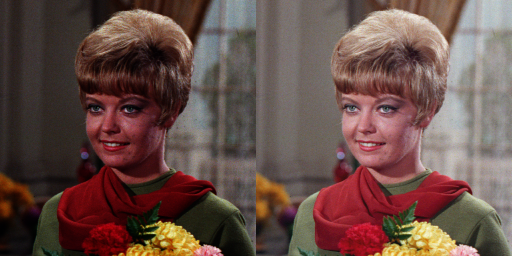

In [19]:
print('Mengubah tingkat kecerahan Citra (Gamma Correction)')
print('--------------------------------------------------')
try:
    gamma = float(input('Masukan nilai gamma (misal: 0.5 atau 2.0): '))
except:
    print('Nilai harus berupa angka')

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

gamma_image = np.zeros(original.shape, dtype=np.uint8)

# Terapkan rumus secara manual dengan for
for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        for c_channel in range(original.shape[2]):
            I = original[y, x, c_channel]  # nilai intensitas (0–255)
            I_norm = I / 255.0             # normalisasi
            I_corr = 255.0 * (I_norm ** (1.0 / gamma))  # rumus gamma correction
            gamma_image[y, x, c_channel] = np.clip(I_corr, 0, 255)

final_frame = cv.hconcat((original, gamma_image))
cv2_imshow(final_frame)


Cara lebih mudah:

Mengubah tingkat kecerahan Citra (Gamma Correction)
--------------------------------------------------
Masukan nilai gamma (misal: 0.5 atau 2.0): 3


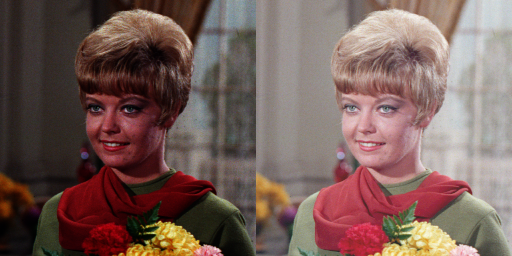

In [17]:
print('Mengubah tingkat kecerahan Citra (Gamma Correction)')
print('--------------------------------------------------')
try:
    gamma = float(input('Masukan nilai gamma (misal: 0.5 atau 2.0): '))
except:
    print('Nilai harus berupa angka')

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

# Ubah ke float
normalized = original / 255.0

# Terapkan rumus gamma correction
gamma_corrected = 255.0 * (normalized ** (1.0 / gamma))

# Kembalikan ke tipe uint8
gamma_image = np.uint8(np.clip(gamma_corrected, 0, 255))

# Gabungkan citra asli dan hasil
final_frame = cv.hconcat((original, gamma_image))
cv2_imshow(final_frame)

## 2. Buat Simulasi Image Depth

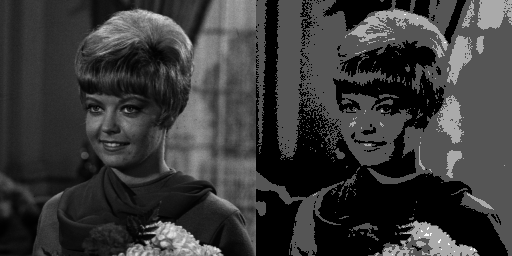

In [27]:
bit_depth=2
level = 255 / (pow(2,bit_depth)-1)
original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff', cv.IMREAD_GRAYSCALE)

quantized = np.zeros(original.shape, dtype=np.uint8)

# Proses kuantisasi manual
for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        I = original[y, x]
        Iq = round(I / level) * level   # kuantisasi
        quantized[y, x] = np.clip(Iq, 0, 255)

cv2_imshow(cv.hconcat((original, quantized)))

cara lain:

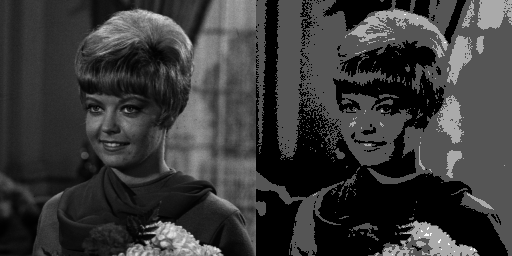

In [28]:
bit_depth = 2
level = 255 / (pow(2, bit_depth) - 1)

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff', cv.IMREAD_GRAYSCALE)

# Kuantisasi tanpa for (langsung NumPy)
quantized = np.round(original / level) * level
quantized = np.clip(quantized, 0, 255).astype(np.uint8)

cv2_imshow(cv.hconcat((original, quantized)))

## 3. Buat modul Average Denoising

Jumlah citra noisy terbaca: 100
PSNR untuk 100 citra average = 19.9220 dB


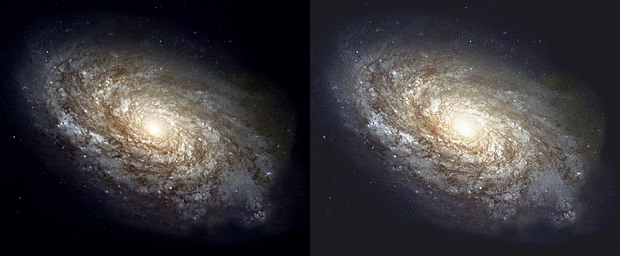

In [75]:
import cv2 as cv
import numpy as np
import glob
from google.colab.patches import cv2_imshow

# Fungsi menghitung PSNR
def calculate_psnr(img1, img2):
    mse = np.mean((img1.astype(np.float32) - img2.astype(np.float32)) ** 2)
    if mse == 0:
        return float('inf')  # jika sama persis
    psnr = 10 * np.log10((255 ** 2) / mse)
    return psnr

# Baca semua citra noisy
cv_img = []
for img in glob.glob('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/noises/*.jpg'):
    n = cv.imread(img, cv.IMREAD_COLOR)
    if n is not None:
        cv_img.append(n.astype(np.float32))

print("Jumlah citra noisy terbaca:", len(cv_img))

# Baca citra asli
original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/galaxy.jpg', cv.IMREAD_COLOR)

# Tentukan jumlah citra yang ingin dirata-rata
N = 100
avg_image = np.mean(cv_img[:N], axis=0)
avg_image = np.clip(avg_image, 0, 255).astype(np.uint8)

# Hitung PSNR terhadap citra asli
psnr_value = calculate_psnr(original, avg_image)

# Tampilkan hasil
print(f"PSNR untuk {N} citra average = {psnr_value:.4f} dB")
cv2_imshow(cv.hconcat((original, avg_image)))